In [2]:
import numpy as np
import cv2
import matplotlib.pylab as plt
MINIMAP_SIZE = 280


In [2]:
s4map = plt.imread('Fortnite-map-season4-high-res.jpg')
test5x5 = plt.imread('test5x5.jpg')
test2x2 = plt.imread('testTile2x2.jpg')
testTile = plt.imread('test tile.jpg')
checked = np.zeros((s4map.shape[0], s4map.shape[1]))

def readTileTo1D(x, y, image, tileSize):
    tile = np.zeros(tileSize * tileSize)
    for i in range(tileSize):
        for j in range(tileSize):
            tile[i * tileSize + j] = image[y + i][x + j][1]
    return tile

def readTileTo2D(x, y, image, tileSize):
    tile = np.zeros((tileSize, tileSize))
    for i in range(tileSize):
        for j in range(tileSize):
            tile[i][j] = image[y + i][x + j][1]
    return tile

def convert2DTo1D(tile):
    rows, cols = tile.shape[0], tile.shape[1]
    vec = np.zeros(rows * cols)
    for i in range(rows):
        for j in range(cols):
            vec[i * cols + j] = tile[i][j]
    return vec

def readImageRow(x, y, image, tileSize):
    tile = np.zeros(tileSize)
    for i in range(tileSize):
        tile[i] = image[y][x + i][1]
    return tile
    
def readImageCol(x, y, image, tileSize):
    tile = np.zeros((tileSize, 1))
    for i in range(tileSize):
        tile[i][0] = image[y + i][x][1]
    return tile
    

testTileVec = readTileTo1D(0, 0, testTile, MINIMAP_SIZE)
testTileVecNormal = testTileVec / np.linalg.norm(testTileVec)

testSize = test2x2.shape[0]
testTile2x2Vec = readTileTo1D(0, 0, test2x2, testSize)
testTile2x2VecNormal = testTile2x2Vec / np.linalg.norm(testTile2x2Vec)


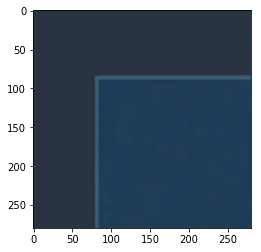

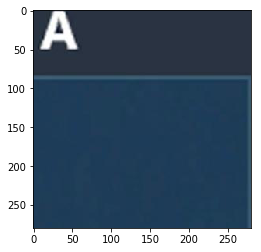

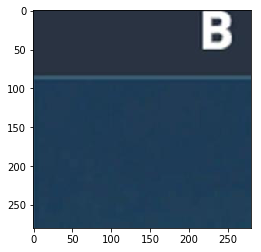

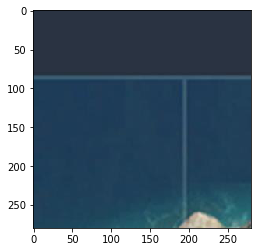

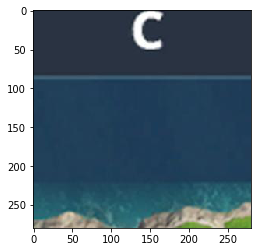

...

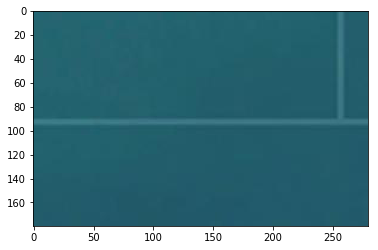

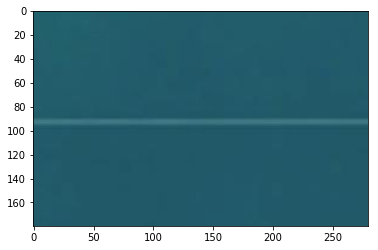

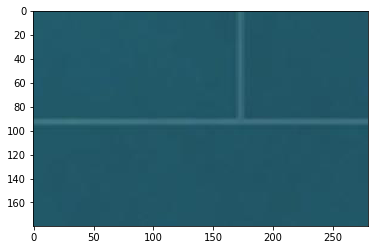

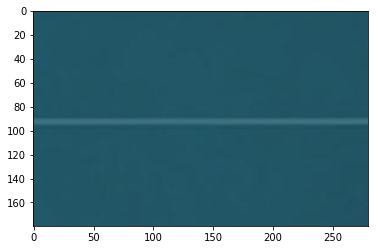

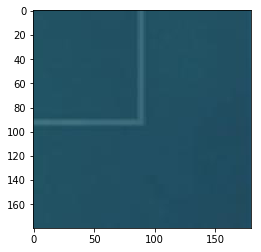

In [3]:
for i in range(s4map.shape[0] // MINIMAP_SIZE + 1):
    for j in range(s4map.shape[1] // MINIMAP_SIZE + 1):
        plt.imshow(s4map[i * MINIMAP_SIZE:(i+1) * MINIMAP_SIZE, j * MINIMAP_SIZE:(j+1) * MINIMAP_SIZE])
        plt.show()
        

In [3]:
#proof of concept version 1
numTiles1D = test5x5.shape[0] - testSize + 1
maxI, maxJ, maxDot = -1, -1, -1
for y in range(numTiles1D):
    for x in range(numTiles1D):
        tile = readTileTo1D(x, y, test5x5, testSize)
        tileNormal = tile / np.linalg.norm(tile)
        dot = np.dot(tileNormal, testTile2x2VecNormal)
        print((x, y), dot, tile)
        if (dot > maxDot):
            maxI, maxJ, maxDot = x, y, dot
print()
print((maxI, maxJ))


(0, 0) 0.9425784243032441 [ 22.  22. 222. 221.]
(1, 0) 0.90471104760823 [ 22.  23. 221. 126.]
(2, 0) 0.6447883498866809 [ 23. 181. 126.  50.]
(3, 0) 0.5086688952533296 [181. 221.  50.  22.]
(0, 1) 0.9094913658392542 [222. 221. 221. 220.]
(1, 1) 0.9544037930575605 [221. 126. 220. 201.]
(2, 1) 0.999986093203443 [126.  50. 201. 221.]
(3, 1) 0.9632485995324678 [ 50.  22. 221. 186.]
(0, 2) 0.8360244651456733 [221. 220. 255. 113.]
(1, 2) 0.6806471043974692 [220. 201. 113.  54.]
(2, 2) 0.5193082695809816 [201. 221.  54.  22.]
(3, 2) 0.48973056459017084 [221. 186.  22.  24.]
(0, 3) 0.7777557513494817 [255. 113.  21. 221.]
(1, 3) 0.7888888517309146 [113.  54. 221.  22.]
(2, 3) 0.8968305991713634 [54. 22. 22. 93.]
(3, 3) 0.9435833661217429 [ 22.  24.  93. 158.]

(2, 1)


In [4]:
#proof of concept version 2
maxX, maxY, maxDot = -1, -1, -1
def findBestMatch(vec):
    startTile = readTileTo2D(0, 0, test5x5, testSize)
    findBestMatchHelper(0, 0, startTile)
    
def findBestMatchHelper(x, y, tile):
    global maxX, maxY, maxDot
    vec = convert2DTo1D(tile)
    vecNormal = vec / np.linalg.norm(vec)
    dot = np.dot(vecNormal, testTile2x2VecNormal)
    print((x, y), dot, vec)
    if (dot > maxDot):
        maxX, maxY, maxDot = x, y, dot
    if (x < test5x5.shape[0] - testSize):
        newCol = readImageCol(x + testSize, y, test5x5, testSize)
        newTileCol = np.delete(tile, 0, 1)
        newTileCol = np.hstack([newTileCol, newCol])
        findBestMatchHelper(x + 1, y, newTileCol)
    if (x == 0 and y < test5x5.shape[0] - testSize):
        newRow = readImageRow(x, y + testSize, test5x5, testSize)
        newTileRow = np.delete(tile, 0, 0)
        newTileRow = np.vstack([newTileRow, newRow])
        findBestMatchHelper(x, y + 1, newTileRow)

findBestMatch(testTile2x2VecNormal)
print()
print((maxX, maxY))


(0, 0) 0.9425784243032441 [ 22.  22. 222. 221.]
(1, 0) 0.90471104760823 [ 22.  23. 221. 126.]
(2, 0) 0.6447883498866809 [ 23. 181. 126.  50.]
(3, 0) 0.5086688952533296 [181. 221.  50.  22.]
(0, 1) 0.9094913658392542 [222. 221. 221. 220.]
(1, 1) 0.9544037930575605 [221. 126. 220. 201.]
(2, 1) 0.999986093203443 [126.  50. 201. 221.]
(3, 1) 0.9632485995324678 [ 50.  22. 221. 186.]
(0, 2) 0.8360244651456733 [221. 220. 255. 113.]
(1, 2) 0.6806471043974692 [220. 201. 113.  54.]
(2, 2) 0.5193082695809816 [201. 221.  54.  22.]
(3, 2) 0.48973056459017084 [221. 186.  22.  24.]
(0, 3) 0.7777557513494817 [255. 113.  21. 221.]
(1, 3) 0.7888888517309146 [113.  54. 221.  22.]
(2, 3) 0.8968305991713634 [54. 22. 22. 93.]
(3, 3) 0.9435833661217429 [ 22.  24.  93. 158.]

(2, 1)


In [ ]:
maxX, maxY, maxDot = -1, -1, -1
def findBestMatch(vec):
    startTile = readTileTo2D(0, 0, s4map, MINIMAP_SIZE)
    findBestMatchHelper(0, 0, startTile)
    
def findBestMatchHelper(x, y, tile):
    global maxX, maxY, maxDot
    vec = convert2DTo1D(tile)
    vecNormal = vec / np.linalg.norm(vec)
    dot = np.dot(vecNormal, testTileVecNormal)
    print((x, y))
    if (dot > maxDot):
        maxX, maxY, maxDot = x, y, dot
    if (x < s4map.shape[0] - MINIMAP_SIZE):
        newCol = readImageCol(x + testSize, y, s4map, MINIMAP_SIZE)
        newTileCol = np.delete(tile, 0, 1)
        newTileCol = np.hstack([newTileCol, newCol])
        findBestMatchHelper(x + 1, y, newTileCol)
    if (x == 0 and y < s4map.shape[0] - MINIMAP_SIZE):
        newRow = readImageRow(x, y + testSize, s4map, MINIMAP_SIZE)
        newTileRow = np.delete(tile, 0, 0)
        newTileRow = np.vstack([newTileRow, newRow])
        findBestMatchHelper(x, y + 1, newTileRow)
    

findBestMatch(testTileVecNormal)
print()
print((maxX, maxY))


(0, 0)
(1, 0)
(2, 0)
(3, 0)
(4, 0)
(5, 0)
(6, 0)
(7, 0)
(8, 0)
(9, 0)
(10, 0)
(11, 0)
(12, 0)
(13, 0)
(14, 0)
(15, 0)
(16, 0)
(17, 0)
(18, 0)
(19, 0)
(20, 0)
(21, 0)
(22, 0)
(23, 0)
(24, 0)
(25, 0)
(26, 0)
(27, 0)
(28, 0)
(29, 0)
(30, 0)
(31, 0)
(32, 0)
(33, 0)
(34, 0)
(35, 0)
(36, 0)
(37, 0)
(38, 0)
(39, 0)
(40, 0)
(41, 0)
(42, 0)
(43, 0)
(44, 0)
(45, 0)
(46, 0)
(47, 0)
(48, 0)
(49, 0)
(50, 0)
(51, 0)
(52, 0)
(53, 0)
(54, 0)
(55, 0)
(56, 0)
(57, 0)
(58, 0)
(59, 0)
(60, 0)
(61, 0)
(62, 0)
(63, 0)
(64, 0)
(65, 0)
(66, 0)
(67, 0)
(68, 0)
(69, 0)
(70, 0)
(71, 0)
(72, 0)
(73, 0)
(74, 0)
(75, 0)
(76, 0)
(77, 0)
(78, 0)
(79, 0)
(80, 0)
(81, 0)
(82, 0)
(83, 0)
(84, 0)
(85, 0)
(86, 0)
(87, 0)
(88, 0)
(89, 0)
(90, 0)
(91, 0)
(92, 0)
(93, 0)
(94, 0)
(95, 0)
(96, 0)
(97, 0)
(98, 0)
(99, 0)
(100, 0)
(101, 0)
(102, 0)
(103, 0)
(104, 0)
(105, 0)
(106, 0)
(107, 0)
(108, 0)
(109, 0)
(110, 0)
(111, 0)
(112, 0)
(113, 0)
(114, 0)
(115, 0)
(116, 0)
(117, 0)
(118, 0)
(119, 0)
(120, 0)
(121, 0)
(122, 0)
(12